<h1 align="center">Volume 2: The Fourier Transform.</h1>

    Everett Bergeson
    <Class>
    <Date>

<h2 align="center">Part 1: The Discrete Fourier Transform</h2>

In [1]:
from matplotlib import pyplot as plt
from scipy.io import wavfile
import numpy as np
import IPython
from scipy.signal import fftconvolve
from scipy.fftpack import fft, ifft, fft2, ifft2
import imageio

In [2]:
plt.rcParams["figure.dpi"] = 300             # Fix plot quality.
plt.rcParams["figure.figsize"] = (12,3)      # Change plot size / aspect (you may adjust this).

In [3]:
class SoundWave(object):
    """A class for working with digital audio signals."""

    # Problem 1.1
    def __init__(self, rate, samples):
        """Set the SoundWave class attributes.

        Parameters:
            rate (int): The sample rate of the sound.
            samples ((n,) ndarray): NumPy array of samples.
        """
        self.rate = rate
        self.samples = samples
        

    # Problems 1.1 and 1.7
    def plot(self, graph_dft=False):
        """Plot the graph of the sound wave (time versus amplitude)."""
        if graph_dft == False:
            x = np.linspace(0,len(self.samples)/self.rate, len(self.samples))
            plt.ylim(-32768, 32767)
            plt.plot(x, self.samples)
        else:
            dft = np.abs(fft(self.samples))
            x = np.linspace(0, self.rate//2, len(self.samples)//2)
            m = len(dft)//2
            plt.plot(x, dft[:m])
        plt.show


    # Problem 1.2
    def export(self, filename, force=False):
        """Generate a wav file from the sample rate and samples. 
        If the array of samples is not of type np.int16, scale it before exporting.

        Parameters:
            filename (str): The name of the wav file to export the sound to.
        """
        # See if we need to scale the samples 
        if force==True or self.samples.dtype != 'int16':
            wavfile.write(filename, self.rate, np.int16(self.samples/max(self.samples)*32767))
        else:
            wavfile.write(filename, self.rate, self.samples)
    
    # Problem 1.4
    def __add__(self, other):
        """Combine the samples from two SoundWave objects.

        Parameters:
            other (SoundWave): An object containing the samples to add
                to the samples contained in this object.
        
        Returns:
            (SoundWave): A new SoundWave instance with the combined samples.

        Raises:
            ValueError: if the two sample arrays are not the same length.
        """
        if len(self.samples) != len(other.samples):
            raise ValueError("Samples are different lengths")
            
        return SoundWave(self.rate, self.samples + other.samples)
        
    # Problem 1.4
    def __rshift__(self, other):
        """Concatentate the samples from two SoundWave objects.

        Parameters:
            other (SoundWave): An object containing the samples to concatenate
                to the samples contained in this object.

        Raises:
            ValueError: if the two sample rates are not equal.
        """
        if self.rate != other.rate:
            raise ValueError("Rates are different")
            
        return SoundWave(self.rate, np.concatenate((self.samples, other.samples)))
    
    # Problem 2.1
    def __mul__(self, other):
        """Convolve the samples from two SoundWave objects using circular convolution.
        
        Parameters:
            other (SoundWave): An object containing the samples to convolve
                with the samples contained in this object.
        
        Returns:
            (SoundWave): A new SoundWave instance with the convolved samples.

        Raises:
            ValueError: if the two sample rates are not equal.
        """
        if self.rate != other.rate:
            raise ValueError("Rates are different")
        
        # If samples are different length, add zeros to the end of one to make them equal
        diff = len(self.samples) - len(other.samples)
        if diff > 0:
            other.samples = np.pad(other.samples, (0, diff, 'constant'))
        elif diff < 0:
            self.samples = np.pad(self.samples, (0, diff*(-1)), 'constant')
        
        # Use 7.4 to calculate
        convSamp = ifft(np.multiply(fft(self.samples), fft(other.samples))).real
        
        return SoundWave(self.rate, convSamp)

    # Problem 2.2
    def __pow__(self, other):
        """Convolve the samples from two SoundWave objects using linear convolution.
        
        Parameters:
            other (SoundWave): An object containing the samples to convolve
                with the samples contained in this object.
        
        Returns:
            (SoundWave): A new SoundWave instance with the convolved samples.

        Raises:
            ValueError: if the two sample rates are not equal.
        """
        if self.rate != other.rate:
            raise ValueError("Rates are different")
        
        # Compute the smallest 2^a such that 2^a >= n + m - 1
        size = len(self.samples) + len(other.samples) - 1
        pow2 = 2
        while pow2 < size:
            pow2 = pow2*2
                
        # Add zeros until both 
        other.samples = np.pad(other.samples, (0, (pow2-len(other.samples))), 'constant')
        self.samples = np.pad(self.samples, (0, (pow2-len(self.samples))), 'constant')
    
        # Use 7.4 to calculate
        convSamp = ifft(np.multiply(fft(self.samples), fft(other.samples))).real
        
        return SoundWave(self.rate, convSamp[:size])

    # Problem 2.4
    def clean(self, low_freq, high_freq):
        """Remove a range of frequencies from the samples using the DFT. 

        Parameters:
            low_freq (float): Lower bound of the frequency range to zero out.
            high_freq (float): Higher boound of the frequency range to zero out.
        """
        n = len(self.samples)
        clean_dft = fft(self.samples)
        # Compute the integer indices klow and khigh corresponding to vlow and vhigh
        khigh = int(high_freq*n/self.rate)
        klow = int(low_freq*n/self.rate)
        # Set the entries of the DFT from klow to khigh and n-khigh to n-klow to zero
        clean_dft[klow:khigh] = 0
        clean_dft[n-khigh:n-klow] = 0
        # Take the IDFT of the DFT to get the cleaned signal
        self.samples = ifft(clean_dft).real

### Problem 1.1

- Implement `SoundWave.__init__()`.
- Implement `SoundWave.plot()`.
- Use the `scipy.io.wavfile.read()` and the `SoundWave` class to plot `tada.wav`.

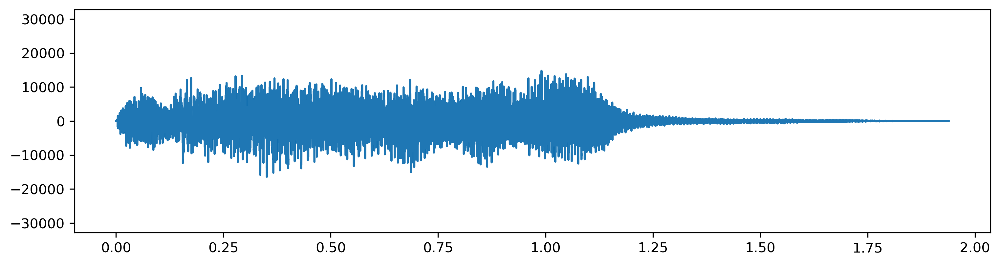

In [4]:
rate, samples = wavfile.read("tada.wav")
tada = SoundWave(rate, samples)
tada.plot()

### Problem 1.2

- Implement `SoundWave.export()`.
- Use the `export()` method to create two new files containing the same sound as `tada.wav`: one without scaling, and one with scaling (use `force=True`).
- Use `IPython.display.Audio()` to embed the original and new versions of `tada.wav` in the notebook.

In [5]:
print("tada.wav")
IPython.display.Audio(filename="tada.wav")

tada.wav


In [6]:
tada.export("tada_noscale.wav")
print("Non-scaled tada.wav")
IPython.display.Audio(filename="tada_noscale.wav")

Non-scaled tada.wav


In [7]:
tada.export("tada_scaled.wav", force=True)
print("Scaled tada.wav")
IPython.display.Audio(filename="tada_scaled.wav")

Scaled tada.wav


### Problem 1.3

- Implement `generate_note()`.
- Use `generate_note()` to create an A tone that lasts for two seconds. Embed it in the notebook.

In [8]:
def generate_note(frequency, duration):
    """Generate an instance of the SoundWave class corresponding to 
    the desired soundwave. Uses sample rate of 44100 Hz.
    
    Parameters:
        frequency (float): The frequency of the desired sound.
        duration (float): The length of the desired sound in seconds.
    
    Returns:
        sound (SoundWave): An instance of the SoundWave class.
    """
    x = np.linspace(0, duration, int(44100*duration))
    samp = np.sin(2 * np.pi * x * frequency)
    return SoundWave(44100, samp)

In [9]:
A_2sec = generate_note(440, 2)
A_2sec.export("A_2sec.wav", force=True)

IPython.display.Audio(filename="A_2sec.wav")

### Problem 1.4

- Implement `SoundWave.__add__()`.
- Generate a three-second A minor chord (A, C, and E) and embed it in the notebook.
- Implement `SoundWave.__rshift__()`.
- Generate the arpeggio A$\,\rightarrow\,$C$\,\rightarrow\,$E, where each tone lasts one second, and embed it in the notebook.

In [10]:
# Create notes
A = generate_note(440, 3)
C = generate_note(523.5, 3)
E = generate_note(659.25, 3)
# Add the notes
chord = A + C + E

# Export and display
chord.export("minor_chord_ACE.wav")
IPython.display.Audio(filename="minor_chord_ACE.wav")

In [11]:
# Create notes
A = generate_note(440, 1)
C = generate_note(523.5, 1)
E = generate_note(659.25, 1)

# Shift the notes
arpeggio = A >> C >> E

# Export and display
arpeggio.export("arpeggio_ACE.wav")
IPython.display.Audio(filename="arpeggio_ACE.wav")

### Problem 1.5

- Implement `simple_dft()` with the formula $c=F_nf$, where $F_n$ is the n-dimensional DFT matrix.
- Use `np.allclose()` to check that `simple_dft()` and `scipy.fftpack.fft()` give the same result (after scaling).

In [12]:
def simple_dft(samples):
    """Compute the DFT of an array of samples.

    Parameters:
        samples ((n,) ndarray): an array of samples.
    
    Returns:
        ((n,) ndarray): The DFT of the given array.
    """
    n = len(samples)
    m = np.arange(n).reshape(n,1)
    W = np.exp((-2j * np.pi/n) * m @ m.T)
    
    return np.round(W @ samples / n, 10)

In [13]:
samples = np.random.randint(-32768, 32767, 8192, dtype=np.int16)
np.allclose(simple_dft(samples), fft(samples)/8192)

True

### Problem 1.6

- Implement `simple_fft()`.
- Generate an array of $8192$ random samples and take its DFT using `simple_dft()`, `simple_fft()`, and `scipy.fftpack.fft()`.
Print the runtimes of each computation.
- Use `np.allclose()` to check that `simple_fft()` and `scipy.fftpack.fft()` give the same result (after scaling).

In [40]:
def simple_fft(samples, threshold=1):
    """Compute the DFT using the FFT algorithm.
    
    Parameters:
        samples ((n,) ndarray): an array of samples.
        threshold (int): when a subarray of samples has fewer
            elements than this integer, use simple_dft() to
            compute the DFT of that subarray.
    
    Returns:
        ((n,) ndarray): The DFT of the given array.
    """
    def split(g):
        n = len(g)
        if n <= threshold:
            return simple_dft(g)
        
        else:
            even = split(g[::2])
            odd = split(g[1::2])
            
            z = np.arange(n)
            z = np.exp(-2j * np.pi * z/n)
            m=n//2
            firstpart = even + np.multiply(z[:m], odd)
            secondpart = even + np.multiply(z[m:], odd)
            return np.hstack((firstpart, secondpart))
            
    return split(samples)/len(samples)



In [41]:
samples = np.random.randint(-32768, 32767, 8192, dtype=np.int16)
print("DFT time:")
%time simple_dft(samples)
print("FFT time:")
%time simple_fft(samples)
print("scipy FFT time:")
%time fft(samples)/8192

np.allclose(simple_fft(samples), fft(samples)/8192)


DFT time:
Wall time: 8.48 s
FFT time:
Wall time: 788 ms
scipy FFT time:
Wall time: 0 ns
10.4 ms ± 740 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


### Problem 1.7

- Modify `SoundWave.plot()` so that it accepts a boolean. When the boolean is `True`, take the DFT of the stored samples and plot (in a new subplot) the frequencies present on the $x$-axis and the magnituds of those frequences on the $y$-axis. Only the display the first half of the plot, and adjust the $x$-axis so that it correctly shows the frequencies in Hertz.
- Display the plot of the DFT of an A tone.
- Display the plot of the DFT of an A minor chord.

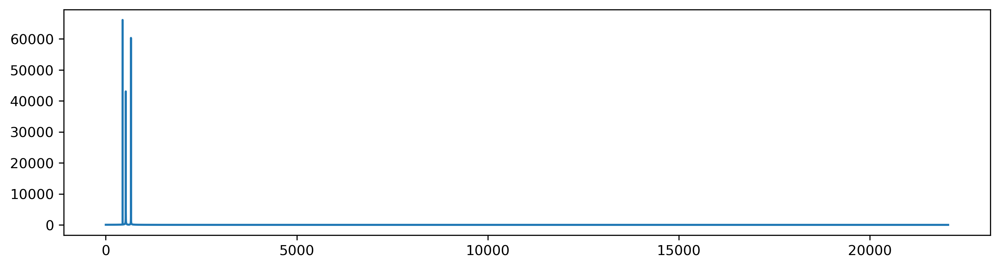

In [16]:
chord.plot(graph_dft=True)

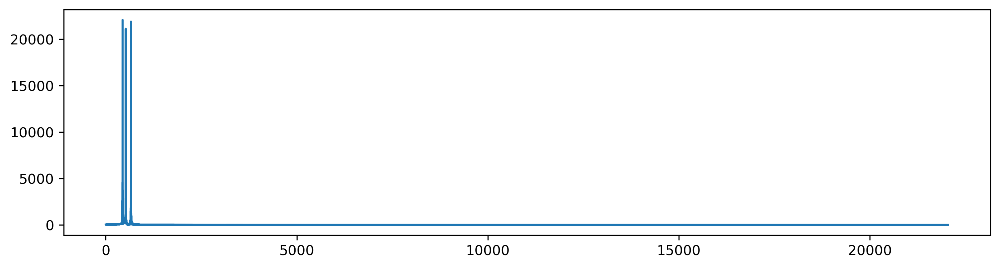

In [17]:
# Create notes
A = generate_note(440, 1)
C = generate_note(523.5, 1)
E = generate_note(659.25, 1)

# Shift the notes
arpeggio = A >> C >> E
arpeggio.plot(graph_dft=True)

### Problem 1.8

Use the DFT to determine the individual notes that are present in `mystery_chord.wav`.

[587.5  523.25 784.   440.  ]


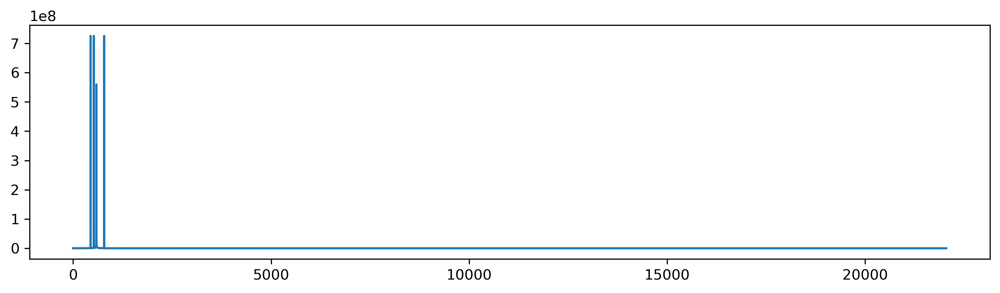

In [18]:
rate, samples = wavfile.read("mystery_chord.wav")
mystery = SoundWave(rate, samples)
mystery.plot(graph_dft=True)
mys_dft = fft(mystery.samples)
top4 = np.argsort(np.abs(mys_dft[:len(samples)//2]))
print(top4[-4:]*mystery.rate/len(mystery.samples))
IPython.display.Audio(filename="mystery_chord.wav")

In [19]:
# Create notes
A = generate_note(440, 3)
C = generate_note(523.25, 3)
D = generate_note(587.33, 3)
G = generate_note(784, 3)
# Add the notes
chord = A + C + G + D

# Export and display
chord.export("unknown.wav")
IPython.display.Audio(filename="unknown.wav")

The notes are... A, C, D, G

<h2 align="center">Part 2: Convolution and Filtering.</h2>

### Problem 2.1

- Implement `SoundWave.__mul__()` for circular convolution.
- Generate 2 seconds of white noise at the same sample rate as `tada.wav`.
- Compute the circular convolution of `tada.wav` and the white noise. Embed the result in the notebook.
- Append the circular convolution to itself and embed the result in the notebook.

In [20]:
rate, samples = wavfile.read("tada.wav")
tada = SoundWave(rate, samples)

rate1 = 22050
samples1 = np.random.randint(-32767, 32767, rate1*2, dtype=np.int16)
white_noise = SoundWave(rate1, samples1)

convolution = tada*white_noise

convolution.export("convie.wav")
IPython.display.Audio(filename="convie.wav")

In [21]:
convolution = convolution>>convolution
convolution.export("convieApp.wav")
IPython.display.Audio(filename="convieApp.wav")

### Problem 2.2

- Implement `SoundWave.__pow__()` for linear convolution.
- Time the linear convolution of `CGC.wav` and `GCG.wav` using `SoundWave.__pow__()` and `scipy.signal.fftconvolve()`.
- Embed the two original sounds and their convolutions in the notebook. Check that the convolutions with `SoundWave.__pow__()` and `scipy.signal.fftconvolve()` sound the same.

In [22]:
# Create 2 objects
rateC, samplesC = wavfile.read("CGC.wav")
cgc = SoundWave(rateC, samplesC)
print("CGC")
IPython.display.Audio(filename="CGC.wav")

CGC


In [23]:
rateG, samplesG = wavfile.read("GCG.wav")
gcg = SoundWave(rateG, samplesG)
print("GCG")
IPython.display.Audio(filename="GCG.wav")

GCG


In [24]:
# Convolve and time
print("SoundWave.__pow__() time:")
%time convolution = cgc**gcg

# Embed sounds
convolution.export("conv2.wav")
IPython.display.Audio(filename="conv2.wav")

SoundWave.__pow__() time:
Wall time: 144 ms


In [25]:
# Try using scipy.signal.fftconvolve
print("scipy.signal.fftconvolve() time:")
%time scipy_conv = fftconvolve(samplesC, samplesG)

# Export 
scipy_wav = SoundWave(rateG, scipy_conv)
scipy_wav.export("scipy_conv2.wav")
IPython.display.Audio(filename="scipy_conv2.wav")

scipy.signal.fftconvolve() time:
Wall time: 52 ms


### Problem 2.3

Use `SoundWave.__pow__()` or `scipy.signal.fftconvolve()` to compute the linear convolution of `chopin.wav` and `balloon.wav`.
Embed the two original sounds and their convolution in the notebook.

In [26]:
chopinRate, chopinSamples = wavfile.read("chopin.wav")
chopin = SoundWave(chopinRate, chopinSamples)
print("Chopin")
IPython.display.Audio(filename="chopin.wav")

Chopin


In [27]:
balloonRate, balloonSamples = wavfile.read("balloon.wav")
balloon = SoundWave(balloonRate, balloonSamples)
print("Balloon")
IPython.display.Audio(filename="balloon.wav")

Balloon


In [28]:
chop_ball_conv = chopin**balloon
chop_ball_conv.export("chop_ball_conv.wav")
print("Chopin and Balloon convolved with SoundWave.__pow__()")
IPython.display.Audio(filename="chop_ball_conv.wav")

Chopin and Balloon convolved with SoundWave.__pow__()


In [29]:
scipy_chop_conv = fftconvolve(chopinSamples, balloonSamples)
# Export 
scipy_chop_wav = SoundWave(balloonRate, scipy_chop_conv)
scipy_chop_wav.export("scipy_conv3.wav")
print("Chopin and Balloon convolved with scipy")
IPython.display.Audio(filename="scipy_conv3.wav")

Chopin and Balloon convolved with scipy


### Problem 2.4

- Implement `SoundWave.clean()`.
- Clean `noisy1.wav` by filtering out frequencies from $1250$-$2600$ Hz. Embed the original and the cleaned versions in the notebook.
- Clean `noisy2.wav`. Embed the original and the cleaned versions in the notebook.

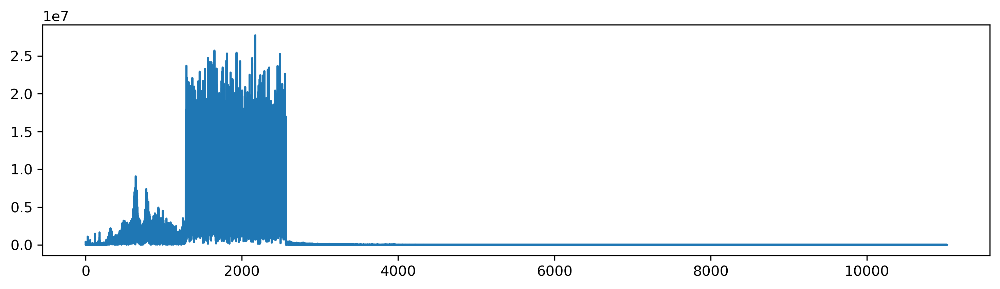

In [30]:
# Original noisy1.wav
rate, samples = wavfile.read("noisy1.wav")
noisy1 = SoundWave(rate, samples)
noisy1.plot(graph_dft=True)
noisy1.export("clean1.wav")
IPython.display.Audio(filename="clean1.wav")

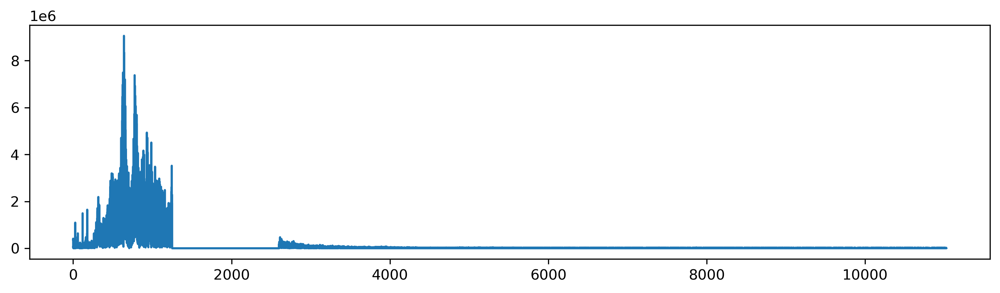

In [31]:
# Cleaned noisy1.wav
noisy1.clean(1250, 2600)
noisy1.plot(graph_dft=True)
noisy1.export("clean1.wav")
IPython.display.Audio(filename="clean1.wav")

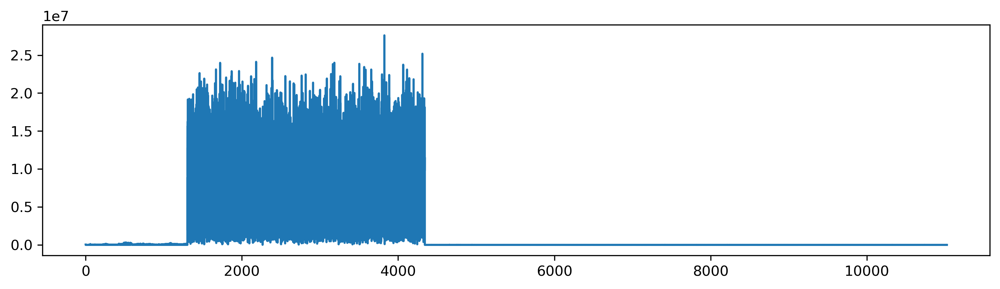

In [32]:
rateN2, samplesN2 = wavfile.read("noisy2.wav")
noisy2 = SoundWave(rateN2, samplesN2)
noisy2.plot(graph_dft=True)
noisy2.export("clean2.wav")
IPython.display.Audio(filename="clean2.wav")

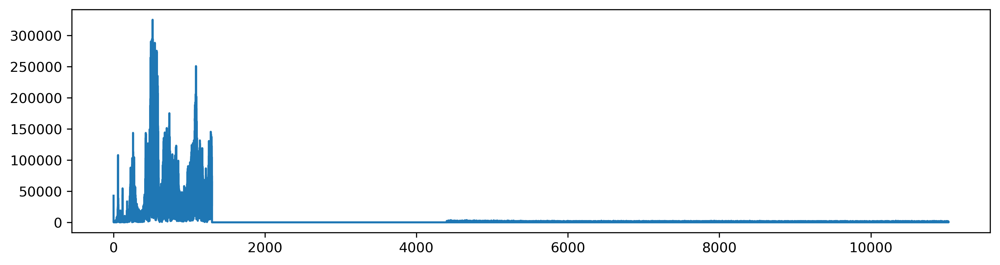

In [33]:
noisy2.clean(1300,4400)
noisy2.plot(graph_dft=True)
noisy2.export("clean2.wav")
IPython.display.Audio(filename="clean2.wav")

### Problem 2.5

- Clean `vuvuzela.wav` by filtering bad frequencies out of the left and right channels individually.
- Recombine the left and right channels and embed the result in the notebook.

In [34]:
# Before cleaning
rateVu, samplesVu = wavfile.read("vuvuzela.wav")
print("Before cleaning")
IPython.display.Audio(filename="vuvuzela.wav")

Before cleaning


Left channel cleaned


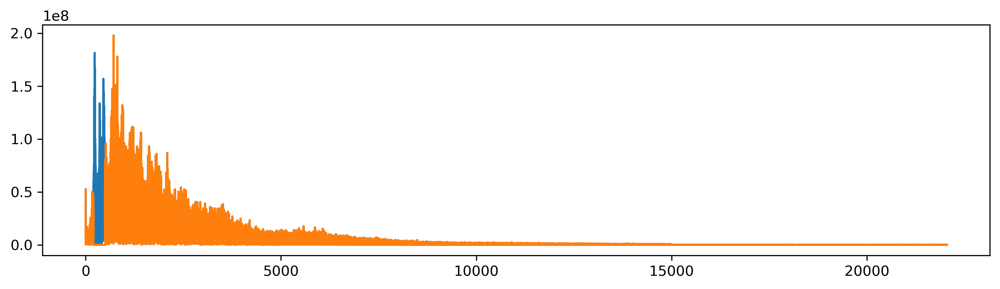

In [35]:


# Start by cleaning left channel
leftVu = SoundWave(rateVu, samplesVu[:,0])
leftVu.plot(graph_dft=True)
leftVu.clean(200,500)
leftVu.plot(graph_dft=True)
leftVu.export("leftVuClean.wav")
print("Left channel cleaned")
IPython.display.Audio(filename="leftVuClean.wav")

Right channel cleaned


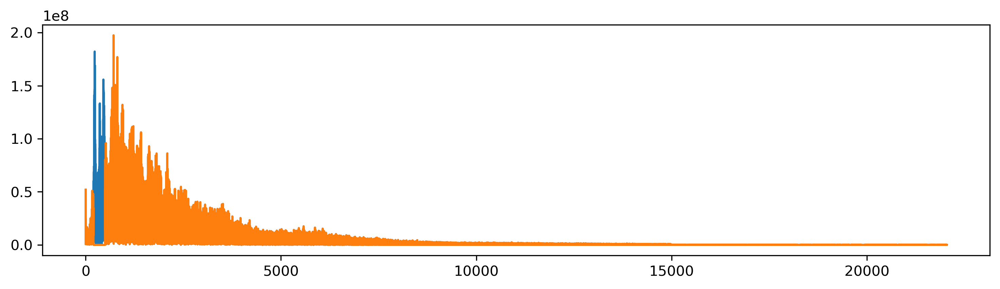

In [36]:
# Then clean right channel
rightVu = SoundWave(rateVu, samplesVu[:,1])
rightVu.plot(graph_dft=True)
rightVu.clean(200,500)
rightVu.plot(graph_dft=True)
rightVu.export("rightVuClean.wav")
print("Right channel cleaned")
IPython.display.Audio(filename="rightVuClean.wav")

Combined cleaned


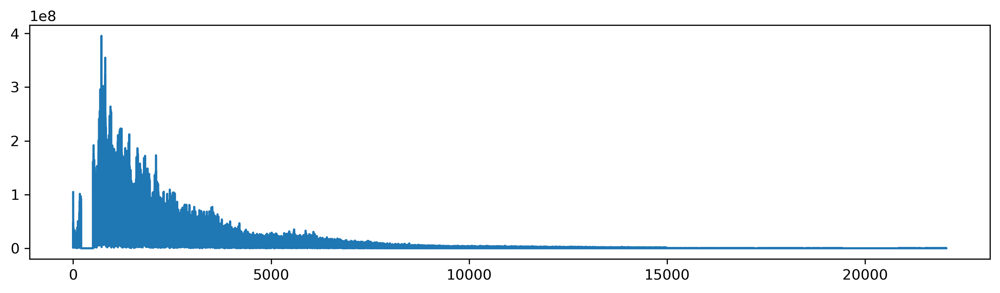

In [37]:
# Recombine channels
combined = rightVu + leftVu
combined.export("combinedVuClean.wav")
print("Combined cleaned")
combined.plot(graph_dft=True)
IPython.display.Audio(filename="combinedVuClean.wav")

### Problem 2.6

- Clean up `license_plate.png` so that the year printed on the sticker in the bottom right corner of the plate is legible.
- Display the original and cleaned images.

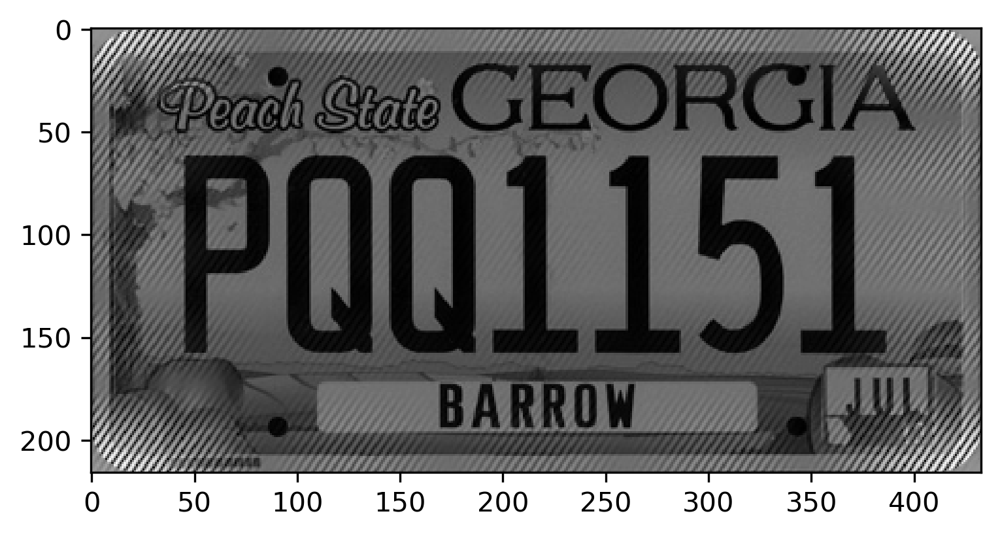

In [38]:
image = imageio.imread("license_plate.png")
plt.imshow(image, cmap='gray')
plt.show()

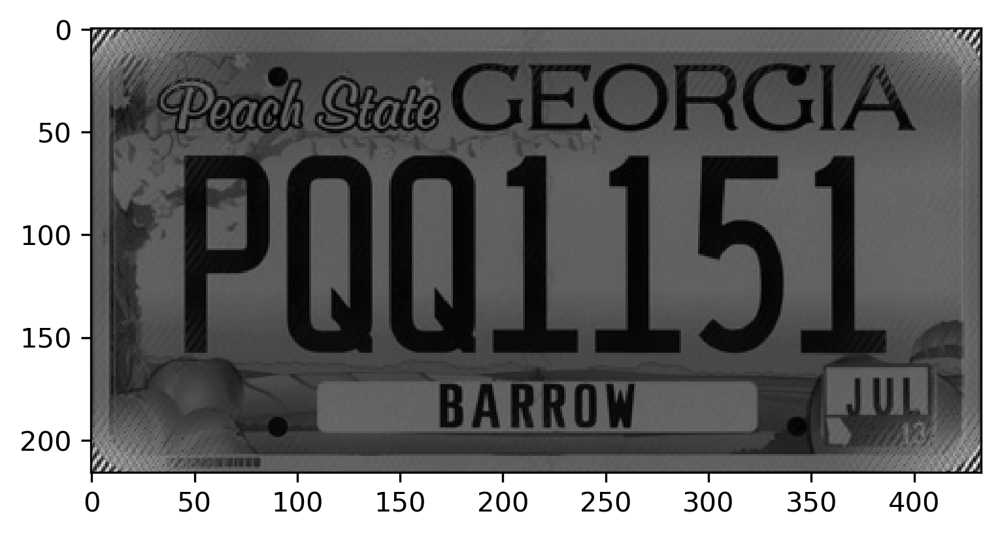

In [39]:
# Plot the log magnitude of the image's DFT.
lic_dft = fft2(image)

for i in range(0,10):
    for j in range(0,10):
        lic_dft[32+i,97+j] = -19502.97068321418-5712.908643223117j
        lic_dft[179+i,330+j] = -32660.426981688517-4353.743441242248j
        lic_dft[175+i,125+j] = -19502.97068321418-5712.908643223117j
        lic_dft[65+i,197+j] = 1577.578478186631+677.3180436189083j
        
plt.imshow(ifft2(lic_dft).real, cmap="gray")
plt.show()



The year on the sticker is...